# Google Earth Engine GEE Feature Extraction for UHI Analysis

This notebook extracts GEE-derived features from Google Earth Engine for Urban Heat Island prediction modelling across study cities.

## Overview

- **Data Source**: Landsat 8/9 Collection 2 Level 2 (2023 summer period)
- **Resolution**: 30m × 30m grid cells (consistent with other notebooks)
- **Features**: 16 literature-optimised GEE metrics for UHI prediction
- **Processing**: Batch export with cloud masking, quality filtering, and proper missing value handling
- **Cities**: Amsterdam, Athens, Barcelona, Berlin, Madrid, Paris

## Feature Categories

1. **Surface Properties** - NDVI, NDBI, Albedo, Impervious Surface, Land Cover
2. **Vegetation Distribution** - Vegetation Fraction, Tree Canopy Cover, Bare Soil Index  
3. **Cooling Resources** - MNDWI, Distance to Water, Distance to Green Spaces, Water Fraction
4. **Thermal Metrics** - LST Mean, LST Max, LST Range, UHI Intensity

## 1. Setup and Configuration

In [30]:
import ee
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import contextily as ctx
import matplotlib as mpl
from tqdm.auto import tqdm
from pathlib import Path
import warnings
import os
import sys

PROJECT_ROOT = Path('..').resolve()
if str(PROJECT_ROOT) not in sys.path:

    sys.path.insert(0, str(PROJECT_ROOT))

FIG_DIR = PROJECT_ROOT / 'results' / 'figures'
FIG_DIR.mkdir(parents=True, exist_ok=True)


from src.bbox_utils import get_aligned_grid_bbox, STUDY_CITIES

warnings.filterwarnings('ignore')
plt.rcParams["figure.figsize"] = (12, 8)



In [31]:
ee.Authenticate()

True

In [32]:
# Initialize Earth Engine 
ee.Initialize(project='urbanheat-dissertation')
print("Google Earth Engine initialised successfully")

Google Earth Engine initialised successfully


In [33]:
# Configuration parameters
BASE_CONFIG = {
    'start_date': '2024-06-21',
    'end_date': '2024-09-21',
    'cloud_threshold': 30,
    'scale': 30,
    'batch_size': 1000,
}

# Processing configuration with smart caching
PROCESSING_CONFIG = {
    'force_download': False,  # Set True to force re-download from GEE
    'check_existing': True,   # Check for existing files before processing
    'min_file_size_mb': 0.3,  # Minimum valid file size
    'export_combined': True,  # Export combined dataset
    'verbose': True           # Detailed logging
}

# Missing value strategy for consistent data handling
MISSING_VALUE_STRATEGY = {
    'indices': np.nan,
    'fractions': np.nan,
    'distances': np.nan,
    'thermal': np.nan,
    'physical': np.nan,
    'moisture': np.nan,
    'meteorology': np.nan,
    'topography': np.nan,
    'categorical': 0
}

OUTPUT_DIR = Path('../data/1-processed/GoogleEarthEngine')
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

GRID_ROOT = Path('../data/utils/grids')
GRID_RESOLUTIONS = [30, 60, 90]
REFERENCE_RESOLUTION = GRID_RESOLUTIONS[0]

GEE_OUTPUT_FILES = {
    res: OUTPUT_DIR / f'All_cities_GEE_features_{res}m.parquet'
    for res in GRID_RESOLUTIONS
}


def _city_slug(city: str) -> str:
    return city.lower().replace(' ', '')


EE_GRID_ASSETS = {
    resolution: {
        city: f"projects/urbanheat-dissertation/assets/{_city_slug(city)}_{resolution}m_grid"
        for city in STUDY_CITIES
    }
    for resolution in GRID_RESOLUTIONS
}

USE_EE_GRID_ASSETS = False  # Force local grids to preserve canonical IDs

GRID_PATHS = {res: GRID_ROOT / f'all_cities_{res}m_grid.parquet' for res in GRID_RESOLUTIONS}
CONFIG = dict(BASE_CONFIG)
GRID_PATH = GRID_PATHS[REFERENCE_RESOLUTION]

print(f"Processing period: {CONFIG['start_date']} to {CONFIG['end_date']}")
print(f"Cloud threshold: {CONFIG['cloud_threshold']}%")
print(f"Batch size: {CONFIG['batch_size']} cells")
print(f"Smart caching: {'Enabled' if PROCESSING_CONFIG['check_existing'] else 'Disabled'}")
print(f"Force download: {'Yes' if PROCESSING_CONFIG['force_download'] else 'No'}")
print(f"Output directory: {OUTPUT_DIR}")
print(f"Grid resolutions: {GRID_RESOLUTIONS}")
print(f"Using EE grid assets: {USE_EE_GRID_ASSETS}")

BUILDING_RESULTS_DIR = Path('../data/1-processed/Buildings')
WORLDCOVER_COLLECTION_ID = 'ESA/WorldCover/v100'
WORLDCOVER_BAND = 'Map'
WORLDCOVER_BUILTUP_CLASS = 50

Processing period: 2024-06-21 to 2024-09-21
Cloud threshold: 30%
Batch size: 1000 cells
Smart caching: Enabled
Force download: No
Output directory: ../data/1-processed/GoogleEarthEngine
Grid resolutions: [30, 60, 90]
Using EE grid assets: False


In [34]:
# Configure high-resolution canopy asset
CANOPY_ASSET_FALLBACK = 'projects/sat-io/open-datasets/facebook/meta-canopy-height'
CANOPY_MIN_HEIGHT_DEFAULT = '3'

if not os.environ.get('GEE_CANOPY_HEIGHT_ASSET'):
    os.environ['GEE_CANOPY_HEIGHT_ASSET'] = CANOPY_ASSET_FALLBACK
    print(f"GEE_CANOPY_HEIGHT_ASSET not set; using default {CANOPY_ASSET_FALLBACK}")
else:
    print(f"Using canopy asset: {os.environ['GEE_CANOPY_HEIGHT_ASSET']}")

if not os.environ.get('GEE_CANOPY_MIN_HEIGHT'):
    os.environ['GEE_CANOPY_MIN_HEIGHT'] = CANOPY_MIN_HEIGHT_DEFAULT
    print(f"GEE_CANOPY_MIN_HEIGHT not set; defaulting to {CANOPY_MIN_HEIGHT_DEFAULT} m")
else:
    print(f"Minimum canopy height (m): {os.environ['GEE_CANOPY_MIN_HEIGHT']}")


Using canopy asset: projects/sat-io/open-datasets/facebook/meta-canopy-height
Minimum canopy height (m): 3


In [35]:
# Literature-based thresholds and feature typing
THRESHOLDS = {
    'vegetation_detection': 0.2,
    'green_space': 0.4,
    'vegetation_strong': 0.4,
    'vegetation_mixed': 0.2,
    'tree_canopy_ndvi': 0.5,
    'water_detection_default': 0.1,
    'water_detection_min': -0.1,
    'water_detection_max': 0.4,
    'water_dynamic_buffer': 0.05,
    'max_distance_default': 500,
    'distance_search_buffer': 5000
}

FEATURE_TYPE_MAPPING = {
    'indices': ['NDVI', 'NDBI', 'MNDWI', 'EVI'],
    'fractions': ['vegetation_fraction', 'water_fraction', 'tree_canopy_cover', 'builtup_fraction_remote'],
    'distances': ['distance_to_water', 'distance_to_green', 'distance_to_coast'],
    'thermal': [
        'LST_mean', 'LST_max', 'LST_range', 'LST_day_mean', 'LST_night_mean',
        'LST_day_night_delta', 'LST_p90', 'LST_std', 'emissivity_mean', 'emissivity_std',
        'UHI_intensity', 'UHI_city_relative', 'UHI_statistical', 'UHI_standardised', 'UHI_severity_class'
    ],
    'physical': ['albedo', 'bare_soil_index', 'canopy_height_mean', 'urban_radiative_index', 'roof_albedo_proxy'],
    'moisture': ['modis_et_mean', 'modis_pet_mean', 'modis_evaporative_fraction'],
    'meteorology': ['era5_wind_speed_mean', 'era5_wind_speed_p95', 'era5_relative_humidity_mean', 'era5_vpd_mean'],
    'topography': ['slope', 'relative_elevation'],
    'categorical': ['land_cover']
}

def create_threshold_feature(image, threshold, greater_than=True, name=None):
    result = (image.gt(threshold) if greater_than else image.lt(threshold))
    if name:
        result = result.rename(name)
    return result.toFloat()

def build_feature_dict(**features):
    return {name: feature for name, feature in features.items() if feature is not None}

print("Feature engineering helper functions loaded")
print(f"Literature-based thresholds: {list(THRESHOLDS.keys())}")
print(f"Feature types for missing value handling: {list(FEATURE_TYPE_MAPPING.keys())}")


Feature engineering helper functions loaded
Literature-based thresholds: ['vegetation_detection', 'green_space', 'vegetation_strong', 'vegetation_mixed', 'tree_canopy_ndvi', 'water_detection_default', 'water_detection_min', 'water_detection_max', 'water_dynamic_buffer', 'max_distance_default', 'distance_search_buffer']
Feature types for missing value handling: ['indices', 'fractions', 'distances', 'thermal', 'physical', 'moisture', 'meteorology', 'topography', 'categorical']


## 2. Data Preparation and Caching

Smart caching system to avoid unnecessary re-processing from Google Earth Engine.

### 2.1 MODIS Night-time LST Setup

Integrate MODIS MYD11A2 night-time land surface temperature composites to complement the Landsat daytime thermal metrics and maintain consistent temporal windows.

In [36]:
# MODIS night-time Land Surface Temperature configuration and helpers
MODIS_NIGHT_COLLECTION_ID = os.environ.get('GEE_MODIS_NIGHT_COLLECTION', 'MODIS/061/MOD11A2')
MODIS_NIGHT_BAND = 'LST_Night_1km'
MODIS_NIGHT_VALID_RANGE = (-90.0, 70.0)

def build_modis_night_composite(bounds, start_date, end_date):
    """Construct a MODIS night-time LST composite in degrees Celsius."""
    if start_date is None or end_date is None:
        start_date = CONFIG.get('start_date')
        end_date = CONFIG.get('end_date')

    end_exclusive = ee.Date(end_date).advance(1, 'day')
    collection = (ee.ImageCollection(MODIS_NIGHT_COLLECTION_ID)
                  .filterDate(start_date, end_exclusive)
                  .filterBounds(bounds))

    def to_celsius(img):
        lst = img.select(MODIS_NIGHT_BAND).multiply(0.02).add(-273.15)
        valid = lst.gt(MODIS_NIGHT_VALID_RANGE[0]).And(lst.lt(MODIS_NIGHT_VALID_RANGE[1]))
        return lst.updateMask(valid).rename('LST_night_mean')

    night_collection = collection.map(to_celsius)

    masked_empty = ee.Image.constant(0).rename('LST_night_mean').updateMask(ee.Image.constant(0))
    night_mean = ee.Image(ee.Algorithms.If(
        night_collection.size().gt(0),
        night_collection.mean(),
        masked_empty
    ))

    return night_mean.resample('bilinear').clip(bounds)

In [37]:
def prepare_landsat_collection(start_date, end_date, bounds, cloud_threshold=30):
    """Prepare cloud-free Landsat 8/9 collection with proper scaling"""
    
    def apply_scale_factors(image):
        """Apply scaling factors to convert from digital numbers to physical values"""
        # Optical bands: scale to reflectance (0-1)
        optical_bands = image.select('SR_B.').multiply(0.0000275).add(-0.2)
        # Thermal bands: scale to temperature (Kelvin)
        thermal_bands = image.select('ST_B.*').multiply(0.00341802).add(149.0)
        return image.addBands(optical_bands, None, True).addBands(thermal_bands, None, True)
    
    def mask_clouds(image):
        """Remove clouds and cloud shadows using QA_PIXEL band"""
        qa = image.select('QA_PIXEL')
        # Bit masks for cloud shadow (bit 4) and clouds (bit 3)
        cloud_shadow_bit_mask = (1 << 4)
        clouds_bit_mask = (1 << 3)
        # Keep pixels where both cloud and shadow bits are 0
        mask = qa.bitwiseAnd(cloud_shadow_bit_mask).eq(0).And(
            qa.bitwiseAnd(clouds_bit_mask).eq(0)
        )
        return image.updateMask(mask)
    
    # Combine Landsat 8 and 9 for better temporal coverage
    collections = []
    
    for gee_collection in ['LANDSAT/LC08/C02/T1_L2', 'LANDSAT/LC09/C02/T1_L2']:
        collection = (ee.ImageCollection(gee_collection)
                     .filterDate(start_date, end_date)
                     .filterBounds(bounds)
                     .filter(ee.Filter.lt('CLOUD_COVER', cloud_threshold))
                     .map(apply_scale_factors)
                     .map(mask_clouds))
        collections.append(collection)
    
    # Merge collections
    merged_collection = collections[0].merge(collections[1])
    
    return merged_collection

In [38]:
def load_worldcover_builtup_fraction(bounds):
    """Return fractional built-up cover from ESA WorldCover at the analysis scale."""
    try:
        worldcover = (ee.ImageCollection(WORLDCOVER_COLLECTION_ID)
                      .select(WORLDCOVER_BAND)
                      .filterBounds(bounds)
                      .first())
        if worldcover is None:
            return None
        builtup_mask = worldcover.eq(WORLDCOVER_BUILTUP_CLASS).toFloat().clip(bounds).unmask(0)
        fraction = (builtup_mask
                    .reduceResolution(ee.Reducer.mean(), maxPixels=65536)
                    .reproject('EPSG:4326', None, CONFIG['scale'])
                    .rename('builtup_fraction_remote'))
        return fraction
    except Exception as exc:
        if PROCESSING_CONFIG.get('verbose', False):
            print(f"WorldCover built-up load failed; falling back to spectral mask: {exc}")
        return None


def fallback_builtup_fraction(ndvi, ndbi, bounds):
    """Fallback mask when ESA WorldCover is unavailable."""
    return (ndbi.gt(0.05).And(ndvi.lt(0.3))).toFloat().clip(bounds).unmask(0).rename('builtup_fraction_remote')

## 3. Core Remote Sensing Features

Calculate Landsat 8/9-derived features for UHI prediction.

In [39]:
def load_canopy_layers(bounds):
    """Load high-resolution canopy layers if the Meta/WRI asset is available."""
    asset_id = os.environ.get('GEE_CANOPY_HEIGHT_ASSET')
    if not asset_id:
        if PROCESSING_CONFIG.get('verbose'):
            print('GEE_CANOPY_HEIGHT_ASSET not set; skipping high-resolution canopy features.')
        return {}

    canopy_image = None
    source_projection = None

    try:
        canopy_image = ee.Image(asset_id)
        # Force evaluation to make sure this is truly an image
        canopy_image.getInfo()
        source_projection = canopy_image.projection()
    except Exception:
        try:
            canopy_collection = ee.ImageCollection(asset_id)
            # get projection from first image in collection
            first_image = ee.Image(canopy_collection.first())
            source_projection = first_image.projection()
            canopy_image = canopy_collection.mosaic()
            if PROCESSING_CONFIG.get('verbose'):
                print(f'Loaded canopy asset {asset_id} as ImageCollection mosaic.')
        except Exception as exc:
            print(f'Warning: Unable to load canopy asset {asset_id}: {exc}')
            return {}

    try:
        if source_projection is not None:
            canopy_image = canopy_image.setDefaultProjection(source_projection, None, source_projection.nominalScale())
        canopy_image = canopy_image.toFloat().clip(bounds)
    except Exception as exc:
        print(f'Warning: Error processing canopy asset {asset_id}: {exc}')
        return {}

    reducer_kwargs = {'reducer': ee.Reducer.mean(), 'maxPixels': 65536}
    projection = ee.Projection('EPSG:4326').atScale(CONFIG['scale'])

    canopy_height_mean = (canopy_image
                          .reduceResolution(**reducer_kwargs)
                          .reproject(projection)
                          .rename('canopy_height_mean'))

    min_height = float(os.environ.get('GEE_CANOPY_MIN_HEIGHT', '3'))
    canopy_cover_fraction = (canopy_image
                             .gt(min_height)
                             .reduceResolution(**reducer_kwargs)
                             .reproject(projection)
                             .rename('tree_canopy_cover'))

    return {
        'canopy_height_mean': canopy_height_mean.toFloat(),
        'tree_canopy_cover': canopy_cover_fraction.toFloat()
    }

In [40]:
def calculate_surface_properties(composite, bounds):
    """Calculate surface property features with robust impervious coverage."""

    ndvi = composite.normalizedDifference(['SR_B5', 'SR_B4']).rename('NDVI')

    evi = composite.expression(
        '2.5 * (NIR - RED) / (NIR + 6 * RED - 7.5 * BLUE + 1)',
        {
            'NIR': composite.select('SR_B5'),
            'RED': composite.select('SR_B4'),
            'BLUE': composite.select('SR_B2')
        }
    ).rename('EVI').clamp(-1, 1)

    ndbi = composite.normalizedDifference(['SR_B6', 'SR_B5']).rename('NDBI')

    albedo = (composite.select('SR_B2').multiply(0.356)
              .add(composite.select('SR_B3').multiply(0.130))
              .add(composite.select('SR_B4').multiply(0.373))
              .add(composite.select('SR_B5').multiply(0.085))
              .add(composite.select('SR_B6').multiply(0.072))
              .add(composite.select('SR_B7').multiply(-0.0018))
              .rename('albedo'))

    builtup_fraction_remote = load_worldcover_builtup_fraction(bounds)
    if builtup_fraction_remote is None:
        builtup_fraction_remote = fallback_builtup_fraction(ndvi, ndbi, bounds)

    land_cover = (ndvi.where(ndvi.gt(THRESHOLDS['vegetation_strong']), 1)
                        .where(ndvi.gt(THRESHOLDS['vegetation_mixed']).And(
                                ndvi.lte(THRESHOLDS['vegetation_strong'])), 2)
                        .where(ndvi.lte(THRESHOLDS['vegetation_mixed']), 3)
                        .rename('land_cover'))

    return build_feature_dict(
        ndvi=ndvi,
        evi=evi,
        ndbi=ndbi,
        albedo=albedo,
        builtup_fraction_remote=builtup_fraction_remote,
        land_cover=land_cover
    )

### 3.2 Vegetation Distribution

Vegetation fraction, tree canopy cover, and bare soil index.

In [41]:
def calculate_vegetation_features(composite, ndvi, canopy_layers=None):
    """Calculate vegetation distribution features (enhanced with high-resolution canopy data when available)."""

    canopy_layers = canopy_layers or {}

    # 6. Vegetation Fraction (binary presence/absence)
    veg_fraction = create_threshold_feature(
        ndvi,
        THRESHOLDS['vegetation_detection'],
        greater_than=True,
        name='vegetation_fraction'
    )

    # 7. Tree Canopy Cover (prefer high-resolution canopy data; fall back to NDVI threshold)
    tree_canopy = canopy_layers.get('tree_canopy_cover')
    canopy_height_mean = canopy_layers.get('canopy_height_mean')

    if tree_canopy is None:
        tree_canopy = create_threshold_feature(
            ndvi,
            THRESHOLDS['tree_canopy_ndvi'],
            greater_than=True,
            name='tree_canopy_cover'
        )
        canopy_height_mean = None

    # 8. Bare Soil Index (BSI) - Spectral index for exposed soil detection
    numerator = (composite.select('SR_B6').add(composite.select('SR_B4')))           # (SWIR1 + Red)
    subtracted = (composite.select('SR_B5').add(composite.select('SR_B2')))         # (NIR + Blue)
    denominator = numerator.add(subtracted)                                         # Total: all bands

    bare_soil = (numerator.subtract(subtracted)
                         .divide(denominator)
                         .rename('bare_soil_index'))

    return build_feature_dict(
        vegetation_fraction=veg_fraction,
        tree_canopy_cover=tree_canopy,
        bare_soil_index=bare_soil,
        canopy_height_mean=canopy_height_mean
    )


### 3.3 Cooling Resources

Water features (MNDWI, water fraction) and distances to water/green spaces.

In [42]:
def calculate_cooling_features(composite, ndvi, canopy_layers, bounds):
    """Calculate cooling resource features with adaptive thresholds and distance metrics."""

    scale = CONFIG['scale']

    mndwi = composite.normalizedDifference(['SR_B3', 'SR_B6']).rename('MNDWI')

    percentiles = mndwi.reduceRegion(
        reducer=ee.Reducer.percentile([90]),
        geometry=bounds,
        scale=scale,
        maxPixels=1e9,
        bestEffort=True
    )

    has_p90 = percentiles.contains('MNDWI_p90')
    threshold_raw = ee.Algorithms.If(
        has_p90,
        ee.Number(percentiles.get('MNDWI_p90')).subtract(THRESHOLDS['water_dynamic_buffer']),
        ee.Number(THRESHOLDS['water_detection_default'])
    )

    water_threshold = (ee.Number(threshold_raw)
                       .max(THRESHOLDS['water_detection_min'])
                       .min(THRESHOLDS['water_detection_max']))

    water_mask = mndwi.gt(water_threshold).rename('water_mask')
    water_fraction = water_mask.toFloat().rename('water_fraction')

    distance_buffer = ee.Number(THRESHOLDS['distance_search_buffer'])
    analysis_geom = bounds.buffer(distance_buffer)

    water_mask_expanded = water_mask.clip(analysis_geom).unmask(0)
    water_present = water_mask_expanded.reduceRegion(
        reducer=ee.Reducer.max(),
        geometry=analysis_geom,
        scale=scale,
        maxPixels=1e9,
        bestEffort=True
    ).get('water_mask')

    water_kernel = ee.Kernel.euclidean(distance_buffer, 'meters')
    distance_to_water = ee.Image(ee.Algorithms.If(
        ee.Number(water_present),
        water_mask_expanded.distance(water_kernel),
        ee.Image.constant(distance_buffer.multiply(2))
    )).toFloat().clip(bounds).rename('distance_to_water')

    green_mask = ndvi.gt(THRESHOLDS['green_space']).rename('green_mask')
    green_mask_expanded = green_mask.clip(analysis_geom).unmask(0)

    green_present = green_mask_expanded.reduceRegion(
        reducer=ee.Reducer.max(),
        geometry=analysis_geom,
        scale=scale,
        maxPixels=1e9,
        bestEffort=True
    ).get('green_mask')

    green_kernel = ee.Kernel.euclidean(distance_buffer, 'meters')
    distance_to_green = ee.Image(ee.Algorithms.If(
        ee.Number(green_present),
        green_mask_expanded.distance(green_kernel),
        ee.Image.constant(distance_buffer.multiply(2))
    )).toFloat().clip(bounds).rename('distance_to_green')

    return build_feature_dict(
        MNDWI=mndwi,
        water_fraction=water_fraction,
        distance_to_water=distance_to_water,
        distance_to_green=distance_to_green
    )


### 3.4 Thermal Metrics

Landsat day-time surface temperature statistics paired with MODIS MYD11A2 night composites to produce robust diurnal UHI indicators.

In [43]:
def calculate_thermal_features(collection, bounds, start_date=None, end_date=None):
    """Calculate thermal metrics using Landsat day data and MODIS night composites."""
    if start_date is None or end_date is None:
        start_date = CONFIG.get('start_date')
        end_date = CONFIG.get('end_date')

    def calculate_lst(image):
        ndvi_img = image.normalizedDifference(['SR_B5', 'SR_B4'])
        fv = ndvi_img.pow(2).rename('FV')
        em = fv.multiply(0.004).add(0.986).rename('EM')
        thermal = image.select('ST_B10')
        lst = thermal.expression(
            '(tb / (1 + (11.5 * tb / 14380) * log(em))) - 273.15',
            {'tb': thermal, 'em': em}
        ).rename('LST')
        return lst.addBands(em.rename('emissivity'))

    lst_collection = collection.map(calculate_lst)

    lst_mean = lst_collection.select('LST').mean().rename('LST_mean')
    lst_max = lst_collection.select('LST').max().rename('LST_max')
    lst_min = lst_collection.select('LST').min().rename('LST_min')
    lst_range = lst_max.subtract(lst_min).rename('LST_range')

    lst_p90 = lst_collection.select('LST').reduce(ee.Reducer.percentile([90])).rename('LST_p90')
    lst_std = lst_collection.select('LST').reduce(ee.Reducer.stdDev()).rename('LST_std')

    day_collection = lst_collection.filterMetadata('SUN_ELEVATION', 'greater_than', 0)
    lst_day_mean = ee.Image(ee.Algorithms.If(
        day_collection.size().gt(0),
        day_collection.select('LST').mean(),
        lst_mean
    )).rename('LST_day_mean')

    lst_night_mean = build_modis_night_composite(
        bounds=bounds,
        start_date=start_date,
        end_date=end_date
    )

    lst_day_night_delta = lst_day_mean.subtract(lst_night_mean).rename('LST_day_night_delta')

    emissivity_mean = lst_collection.select('emissivity').mean().rename('emissivity_mean')
    emissivity_std = lst_collection.select('emissivity').reduce(ee.Reducer.stdDev()).rename('emissivity_std')

    return build_feature_dict(
        LST_mean=lst_mean,
        LST_max=lst_max,
        LST_range=lst_range,
        LST_day_mean=lst_day_mean,
        LST_night_mean=lst_night_mean,
        LST_day_night_delta=lst_day_night_delta,
        LST_p90=lst_p90,
        LST_std=lst_std,
        emissivity_mean=emissivity_mean,
        emissivity_std=emissivity_std
    )

### 3.5 UHI Intensity Targets

City-relative temperature anomalies for model training.

In [44]:
def calculate_uhi_targets(collection, bounds, thermal_features):
    """Derive UHI intensity layers from thermal metrics."""
    lst_mean = thermal_features.get('LST_mean')
    if lst_mean is None:
        raise ValueError('LST_mean is required to compute UHI metrics.')

    mean_dict = lst_mean.reduceRegion(
        reducer=ee.Reducer.mean(),
        geometry=bounds,
        scale=30,
        maxPixels=1e10,
        bestEffort=True
    )
    mean_value = ee.Number(mean_dict.get('LST_mean', 0))
    city_mean_image = ee.Image.constant(mean_value)

    uhi_features = {
        'UHI_intensity': lst_mean.subtract(city_mean_image).rename('UHI_intensity')
    }

    day_mean = thermal_features.get('LST_day_mean')
    if day_mean is not None:
        uhi_features['UHI_day_intensity'] = day_mean.subtract(city_mean_image).rename('UHI_day_intensity')

    return uhi_features


## 4. Auxiliary Environmental Data

Multi-source environmental context beyond core remote sensing.

### 4.1 Meteorological Context (ERA5-Land)

In [45]:
def _project_and_clip(image, bounds):
    """Utility to align ancillary rasters with the 30 m analysis grid."""
    return (ee.Image(image)
            .toFloat()
            .resample('bilinear')
            .reproject('EPSG:4326', None, CONFIG['scale'])
            .clip(bounds))

In [46]:
def calculate_meteorological_features(bounds):
    """Aggregate ERA5-Land hourly products into wind and humidity descriptors."""
    era5 = (ee.ImageCollection('ECMWF/ERA5_LAND/HOURLY')
            .filterDate(CONFIG['start_date'], CONFIG['end_date'])
            .filterBounds(bounds)
            .select(['u_component_of_wind_10m', 'v_component_of_wind_10m', 'temperature_2m', 'dewpoint_temperature_2m']))

    def derive_meteorology(img):
        u = img.select('u_component_of_wind_10m')
        v = img.select('v_component_of_wind_10m')
        wind_speed = u.hypot(v).rename('wind_speed')
        temp_c = img.select('temperature_2m').subtract(273.15)
        dew_c = img.select('dewpoint_temperature_2m').subtract(273.15)

        es = temp_c.expression('0.6108 * exp((17.27 * T) / (T + 237.3))', {'T': temp_c})
        ea = dew_c.expression('0.6108 * exp((17.27 * Td) / (Td + 237.3))', {'Td': dew_c})
        vpd = es.subtract(ea).rename('vpd')
        rh = ea.divide(es.add(1e-6)).multiply(100).clamp(0, 100).rename('relative_humidity')
        return ee.Image.cat([wind_speed, vpd, rh])

    processed = era5.map(derive_meteorology)

    def safe_reduce(collection, band, reducer, name):
        empty = ee.Image.constant(0).rename(name).updateMask(ee.Image.constant(0))
        image = ee.Image(ee.Algorithms.If(
            collection.size().gt(0),
            collection.select(band).reduce(reducer).rename(name),
            empty
        ))
        return _project_and_clip(image, bounds)

    wind_mean = safe_reduce(processed, 'wind_speed', ee.Reducer.mean(), 'era5_wind_speed_mean')
    wind_p95 = safe_reduce(processed, 'wind_speed', ee.Reducer.percentile([95]), 'era5_wind_speed_p95')
    rh_mean = safe_reduce(processed, 'relative_humidity', ee.Reducer.mean(), 'era5_relative_humidity_mean')
    vpd_mean = safe_reduce(processed, 'vpd', ee.Reducer.mean(), 'era5_vpd_mean')

    return build_feature_dict(
        era5_wind_speed_mean=wind_mean,
        era5_wind_speed_p95=wind_p95,
        era5_relative_humidity_mean=rh_mean,
        era5_vpd_mean=vpd_mean
    )

### 4.2 Evapotranspiration Efficiency (MOD16)

ET/PET ratio and EVI for assessing canopy productivity and surface moisture.

In [47]:
def calculate_evapotranspiration_features(bounds):
    """Blend Landsat spectral greenness with MOD16 ET/PET for moisture diagnostics."""
    mod16 = (ee.ImageCollection('MODIS/061/MOD16A2GF')
             .filterDate(CONFIG['start_date'], CONFIG['end_date'])
             .filterBounds(bounds)
             .select(['ET', 'PET']))

    scale_factor = 0.1  # Convert from kg/m^2/8day to mm/8day
    empty = ee.Image.constant(0).updateMask(ee.Image.constant(0))

    et_mean = ee.Image(ee.Algorithms.If(
        mod16.size().gt(0),
        mod16.select('ET').mean().multiply(scale_factor).rename('modis_et_mean'),
        empty.rename('modis_et_mean')
    ))

    pet_mean = ee.Image(ee.Algorithms.If(
        mod16.size().gt(0),
        mod16.select('PET').mean().multiply(scale_factor).rename('modis_pet_mean'),
        empty.rename('modis_pet_mean')
    ))

    et_mean = _project_and_clip(et_mean, bounds)
    pet_mean = _project_and_clip(pet_mean, bounds)

    evap_fraction = et_mean.divide(pet_mean.add(1e-6)).rename('modis_evaporative_fraction')

    return build_feature_dict(
        modis_et_mean=et_mean,
        modis_pet_mean=pet_mean,
        modis_evaporative_fraction=_project_and_clip(evap_fraction, bounds)
    )

### 4.3 Topographic Context (SRTM)

Slope, relative elevation, and distance to coastline for ventilation potential.

In [48]:
def calculate_topography_features(bounds):
    """Capture slope, relative elevation, and maritime exposure."""
    distance_buffer = THRESHOLDS['distance_search_buffer']
    analysis_geom = bounds.buffer(distance_buffer)

    dem = ee.Image('USGS/SRTMGL1_003').select('elevation').toFloat().clip(analysis_geom)
    slope = ee.Terrain.slope(dem).rename('slope')

    stats = ee.Dictionary(dem.reduceRegion(
        reducer=ee.Reducer.median(),
        geometry=bounds,
        scale=90,
        bestEffort=True,
        maxPixels=1e9
    ))
    median_elev = ee.Number(ee.Algorithms.If(stats.contains('elevation'), stats.get('elevation'), 0))
    relative_elevation = dem.subtract(ee.Image.constant(median_elev)).rename('relative_elevation')

    etopo = ee.Image('NOAA/NGDC/ETOPO1').select('bedrock').toFloat().clip(analysis_geom)
    ocean_mask = etopo.lt(0).rename('ocean_mask').unmask(0)

    ocean_stats = ee.Dictionary(ocean_mask.reduceRegion(
        reducer=ee.Reducer.max(),
        geometry=bounds,
        scale=1000,
        bestEffort=True,
        maxPixels=1e9
    ))
    ocean_present = ee.Number(ee.Algorithms.If(ocean_stats.contains('ocean_mask'), ocean_stats.get('ocean_mask'), 0))

    coastline_distance = ee.Image(ee.Algorithms.If(
        ocean_present.gt(0),
        ocean_mask.distance(ee.Kernel.euclidean(distance_buffer, 'meters')),
        ee.Image.constant(distance_buffer * 2)
    )).toFloat().rename('distance_to_coast')

    return build_feature_dict(
        slope=_project_and_clip(slope, bounds),
        relative_elevation=_project_and_clip(relative_elevation, bounds),
        distance_to_coast=_project_and_clip(coastline_distance.clip(bounds), bounds)
    )

## 5. Feature Integration

Combine all feature layers into a single image for export.

In [49]:
def calculate_all_features(collection, bounds, start_date=None, end_date=None):
    """Calculate all remote sensing features for the specified temporal window."""
    if start_date is None or end_date is None:
        start_date = CONFIG.get('start_date')
        end_date = CONFIG.get('end_date')

    composite = collection.median()

    surface_features = calculate_surface_properties(composite, bounds)
    ndvi_image = surface_features['ndvi']
    canopy_layers = load_canopy_layers(bounds)
    vegetation_features = calculate_vegetation_features(composite, ndvi_image, canopy_layers)
    cooling_features = calculate_cooling_features(composite, ndvi_image, canopy_layers, bounds)
    thermal_features = calculate_thermal_features(collection, bounds, start_date, end_date)
    uhi_features = calculate_uhi_targets(collection, bounds, thermal_features)
    meteorology_features = calculate_meteorological_features(bounds)
    moisture_features = calculate_evapotranspiration_features(bounds)
    topography_features = calculate_topography_features(bounds)

    if 'albedo' in surface_features and 'emissivity_mean' in thermal_features:
        urban_radiative_index = thermal_features['emissivity_mean'].multiply(
            ee.Image.constant(1).subtract(surface_features['albedo'])
        ).rename('urban_radiative_index')
        thermal_features['urban_radiative_index'] = urban_radiative_index

    try:
        roof_albedo_proxy = composite.select('SR_B5').divide(
            composite.select('SR_B6').add(1e-6)
        ).rename('roof_albedo_proxy')
        surface_features['roof_albedo_proxy'] = roof_albedo_proxy
    except Exception:
        pass

    feature_image = composite.select([])

    for feature_dict in [
        surface_features,
        vegetation_features,
        cooling_features,
        thermal_features,
        uhi_features,
        meteorology_features,
        moisture_features,
        topography_features
    ]:
        for feature in feature_dict.values():
            feature_image = feature_image.addBands(feature)

    return feature_image

## 6. Processing & Export 

In [50]:
from src.gee_pipeline import (
    configure_pipeline,
    main_processing_with_cache,
    export_combined_dataset,
    create_city_visualisation,
)

configure_pipeline(
    base_config=BASE_CONFIG,
    processing_config=PROCESSING_CONFIG,
    grid_paths=GRID_PATHS,
    grid_resolutions=GRID_RESOLUTIONS,
    reference_resolution=REFERENCE_RESOLUTION,
    output_dir=OUTPUT_DIR,
    study_cities=STUDY_CITIES,
    feature_type_mapping=FEATURE_TYPE_MAPPING,
    missing_value_strategy=MISSING_VALUE_STRATEGY,
)

### 6.1 Run Multi-resolution Processing

In [51]:
# Run the multi-resolution pipeline (30 m, 60 m, 90 m)
results_by_resolution = main_processing_with_cache(
    prepare_landsat_collection,
    calculate_all_features,
    lambda city, size: get_aligned_grid_bbox(city, grid_size=size, cells_per_side=82),
)
results = results_by_resolution.get(REFERENCE_RESOLUTION, {})

GEE FEATURE EXTRACTION
GRID SIZE: 30 m
✓ Amsterdam: Found existing 30 m file (1.7 MB) - skipping
✓ Athens: Found existing 30 m file (2.0 MB) - skipping
✓ Barcelona: Found existing 30 m file (1.6 MB) - skipping
✓ Berlin: Found existing 30 m file (1.6 MB) - skipping
✓ Madrid: Found existing 30 m file (1.8 MB) - skipping
✓ Paris: Found existing 30 m file (1.7 MB) - skipping
Cities to process (30 m): []
Cities skipped (30 m, cached): ['Amsterdam', 'Athens', 'Barcelona', 'Berlin', 'Madrid', 'Paris']
Loaded existing data for Amsterdam (30 m): (6724, 43)
Loaded existing data for Athens (30 m): (6724, 43)
Loaded existing data for Barcelona (30 m): (6724, 43)
Loaded existing data for Berlin (30 m): (6724, 43)
Loaded existing data for Madrid (30 m): (6724, 43)
Loaded existing data for Paris (30 m): (6724, 43)
--------------------------------------------------------------------------------
SUMMARY (30 m)
Total processing time: 0.0 minutes
Cities processed: 0
Cities loaded from cache: 6
Successful

### 6.1 Impervious components
We combine high-resolution building coverage (from notebook 01) with ESA WorldCover built-up fractions to derive roof, paved, and total impervious metrics before exporting each grid.

In [52]:
# Enrich remote features with building coverage to derive roof/paved/total impervious fractions
def _merge_building_impervious(city_df, city_buildings):
    if city_df is None or city_df.empty:
        return city_df
    if city_buildings is None or city_buildings.empty:
        city_df['roof_fraction'] = np.nan
        city_df['paved_fraction'] = np.nan
        if 'builtup_fraction_remote' in city_df.columns:
            city_df['impervious_fraction'] = city_df['builtup_fraction_remote'].clip(0, 1)
        else:
            city_df['impervious_fraction'] = np.nan
        return city_df

    # Drop roof_fraction if it already exists to avoid duplicates after merge
    if 'roof_fraction' in city_df.columns:
        city_df = city_df.drop(columns=['roof_fraction'])

    # Ensure no duplicate index before merging
    city_df = city_df.reset_index(drop=True)
    city_buildings = city_buildings.reset_index(drop=True)

    merged = city_df.merge(city_buildings, on=['city', 'global_grid_id'], how='left', suffixes=('', '_bldg'))
    merged = merged.rename(columns={'building_coverage_ratio': 'roof_fraction'})

    # Ensure roof_fraction is a single Series, not DataFrame
    if isinstance(merged['roof_fraction'], pd.DataFrame):
        merged['roof_fraction'] = merged['roof_fraction'].iloc[:, 0]

    merged['roof_fraction'] = merged['roof_fraction'].clip(lower=0, upper=1)

    # Remove potential duplicate index after merge
    merged = merged.reset_index(drop=True)

    if 'builtup_fraction_remote' in merged.columns:
        merged['builtup_fraction_remote'] = merged['builtup_fraction_remote'].clip(lower=0, upper=1)
        # Use .values to ensure we're working with numpy arrays
        paved = merged['builtup_fraction_remote'].values - merged['roof_fraction'].fillna(0.0).values
        paved = np.clip(paved, 0.0, None)
        merged['paved_fraction'] = paved
    else:
        if 'impervious_fraction' in merged.columns:
            merged['impervious_fraction'] = merged['impervious_fraction'].clip(lower=0.0, upper=1.0)
            merged['paved_fraction'] = np.nan
            return merged
        merged['paved_fraction'] = np.nan

    merged['impervious_fraction'] = merged['roof_fraction'].fillna(0.0).values + merged['paved_fraction'].fillna(0.0).values
    merged['impervious_fraction'] = np.clip(merged['impervious_fraction'], 0.0, 1.0)

    # Drop any remaining duplicate columns (e.g., roof_fraction_bldg)
    duplicate_cols = [col for col in merged.columns if col.endswith('_bldg')]
    if duplicate_cols:
        merged = merged.drop(columns=duplicate_cols)

    return merged

if results_by_resolution:
    for grid_size, city_map in results_by_resolution.items():
        building_path = BUILDING_RESULTS_DIR / f'All_cities_buildings_grid_{grid_size}m.parquet'
        if not building_path.exists():
            print(f"No building coverage file for {grid_size} m grids at {building_path} - skipping impervious merge")
            continue

        building_cols = ['city', 'global_grid_id', 'building_coverage_ratio']
        building_df = pd.read_parquet(building_path, columns=building_cols)
        # Drop duplicates just in case
        building_df = building_df.drop_duplicates(subset=['city', 'global_grid_id'])
        building_groups = {city: group[['city', 'global_grid_id', 'building_coverage_ratio']].copy()
                           for city, group in building_df.groupby('city')}

        for city, city_df in city_map.items():
            if city_df is None or city_df.empty:
                continue
            # Ensure no duplicate grid ids
            city_df = city_df.drop_duplicates(subset=['city', 'global_grid_id'])
            enriched = _merge_building_impervious(city_df.copy(), building_groups.get(city))
            # Ensure index is unique (parquet prefers unique index)
            enriched = enriched.reset_index(drop=True)
            results_by_resolution[grid_size][city] = enriched

            city_file = OUTPUT_DIR / f"{city}_GEE_features_{grid_size}m.parquet"
            enriched.to_parquet(city_file, index=False)
            if PROCESSING_CONFIG.get('verbose', False):
                print(f"Updated {city_file.name} with roof/paved impervious fractions")
else:
    print('No results available to enrich with building coverage')

Updated Amsterdam_GEE_features_30m.parquet with roof/paved impervious fractions
Updated Athens_GEE_features_30m.parquet with roof/paved impervious fractions
Updated Barcelona_GEE_features_30m.parquet with roof/paved impervious fractions
Updated Berlin_GEE_features_30m.parquet with roof/paved impervious fractions
Updated Madrid_GEE_features_30m.parquet with roof/paved impervious fractions
Updated Paris_GEE_features_30m.parquet with roof/paved impervious fractions
Updated Amsterdam_GEE_features_60m.parquet with roof/paved impervious fractions
Updated Athens_GEE_features_60m.parquet with roof/paved impervious fractions
Updated Barcelona_GEE_features_60m.parquet with roof/paved impervious fractions
Updated Berlin_GEE_features_60m.parquet with roof/paved impervious fractions
Updated Madrid_GEE_features_60m.parquet with roof/paved impervious fractions
Updated Paris_GEE_features_60m.parquet with roof/paved impervious fractions
Updated Amsterdam_GEE_features_90m.parquet with roof/paved impervi

### 6.2 Combine City Datasets

In [53]:
# Combine and persist datasets across cities for each resolution
combined_datasets_by_resolution = {}
if results_by_resolution:
    for grid_size, grid_results in results_by_resolution.items():
        combined_dataset = export_combined_dataset(grid_results, grid_size)
        combined_datasets_by_resolution[grid_size] = combined_dataset
        if grid_size == REFERENCE_RESOLUTION:
            globals()['combined_dataset'] = combined_dataset
else:
    print("No results available for export. Run main processing first.")

EXPORTING COMBINED DATASET
✓ Amsterdam: 6,724 cells × 43 features
✓ Athens: 6,724 cells × 43 features
✓ Barcelona: 6,724 cells × 43 features
✓ Berlin: 6,724 cells × 43 features
✓ Madrid: 6,724 cells × 43 features
✓ Paris: 6,724 cells × 43 features
Combined dataset exported to: ../data/1-processed/GoogleEarthEngine/All_cities_GEE_features_30m.parquet
Combined dataset: 40,344 cells × 61 features (13.9 MB)
Export Summary:
--------------------------------------------------
Individual files: 6 cities (10.5 MB total)
Combined file: 13.9 MB
Total export: 24.4 MB
Dataset ready for ML pipeline integration
EXPORTING COMBINED DATASET
✓ Amsterdam: 1,681 cells × 43 features
✓ Athens: 1,681 cells × 43 features
✓ Barcelona: 1,681 cells × 43 features
✓ Berlin: 1,681 cells × 43 features
✓ Madrid: 1,681 cells × 43 features
✓ Paris: 1,681 cells × 43 features
Combined dataset exported to: ../data/1-processed/GoogleEarthEngine/All_cities_GEE_features_60m.parquet
Combined dataset: 10,086 cells × 61 features

In [54]:
# QA: ensure impervious components stay within physical ranges
qa_columns = {
    'builtup_fraction_remote': (0.0, 1.0),
    'roof_fraction': (0.0, 1.0),
    'paved_fraction': (0.0, 1.0),
    'impervious_fraction': (0.0, 1.0)
}

if combined_datasets_by_resolution:
    for grid_size, dataset in combined_datasets_by_resolution.items():
        if dataset is None or dataset.empty:
            print(f"QA {grid_size} m: dataset empty or missing")
            continue
        print(f"QA {grid_size} m: {len(dataset):,} cells")
        for col, (lower, upper) in qa_columns.items():
            if col not in dataset.columns:
                continue
            col_min = dataset[col].min(skipna=True)
            col_max = dataset[col].max(skipna=True)
            assert col_min >= lower - 1e-6, f"{col} min {col_min:.3f} below {lower}"
            assert col_max <= upper + 1e-6, f"{col} max {col_max:.3f} above {upper}"
            print(f"  {col}: min={col_min:.3f}, max={col_max:.3f}")
else:
    print('QA skipped: no combined datasets loaded')

QA 30 m: 40,344 cells
  builtup_fraction_remote: min=0.000, max=1.000
  roof_fraction: min=0.000, max=1.000
  paved_fraction: min=0.000, max=1.000
  impervious_fraction: min=0.000, max=1.000
QA 60 m: 10,086 cells
  builtup_fraction_remote: min=0.000, max=1.000
  roof_fraction: min=0.000, max=1.000
  paved_fraction: min=0.000, max=1.000
  impervious_fraction: min=0.000, max=1.000
QA 90 m: 4,704 cells
  builtup_fraction_remote: min=0.000, max=1.000
  roof_fraction: min=0.000, max=1.000
  paved_fraction: min=0.000, max=1.000
  impervious_fraction: min=0.000, max=1.000


In [55]:
combined_dataset_30m = pd.read_parquet(GEE_OUTPUT_FILES[REFERENCE_RESOLUTION])
combined_dataset_30m.columns

Index(['EVI', 'LST_day_mean', 'LST_day_night_delta', 'LST_max', 'LST_mean',
       'LST_night_mean', 'LST_p90', 'LST_range', 'LST_std', 'MNDWI', 'NDBI',
       'NDVI', 'UHI_day_intensity', 'UHI_intensity', 'albedo',
       'bare_soil_index', 'builtup_fraction_remote', 'canopy_height_mean',
       'city', 'distance_to_coast', 'distance_to_green', 'distance_to_water',
       'emissivity_mean', 'emissivity_std', 'era5_relative_humidity_mean',
       'era5_vpd_mean', 'era5_wind_speed_mean', 'era5_wind_speed_p95',
       'global_grid_id', 'land_cover', 'modis_et_mean',
       'modis_evaporative_fraction', 'modis_pet_mean', 'relative_elevation',
       'roof_albedo_proxy', 'slope', 'tree_canopy_cover',
       'urban_radiative_index', 'vegetation_fraction', 'water_fraction',
       'paved_fraction', 'impervious_fraction', 'roof_fraction',
       'tree_canopy_distance', 'tree_canopy_proximity',
       'dense_vegetation_distance', 'dense_vegetation_proximity',
       'tree_canopy_fraction_90m',

## 7. Visualisation

CREATING GEE FEATURE VISUALISATIONS
Creating LST_mean visualisation (global scale) with both basemaps (no attribution)...


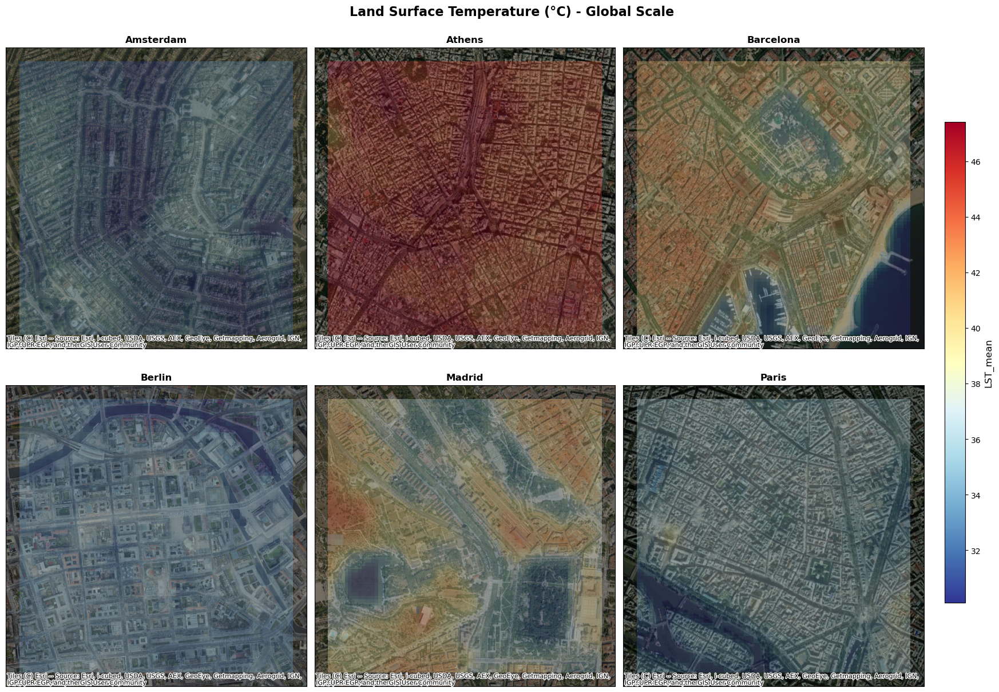

  Saved to /Users/gerardoezequiel/Developer/ShapingCoolCities/results/figures/gee_LST_mean_global.png
Creating LST_mean visualisation (intracity scale) with both basemaps (no attribution)...


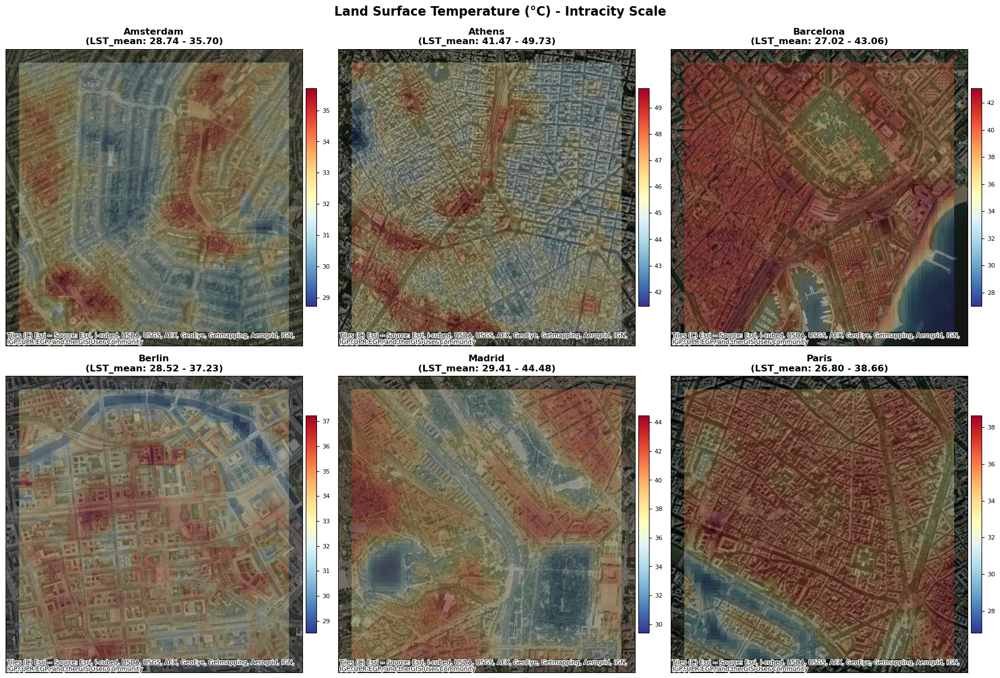

  Saved to /Users/gerardoezequiel/Developer/ShapingCoolCities/results/figures/gee_LST_mean_intracity.png
Creating NDVI visualisation (global scale) with both basemaps (no attribution)...


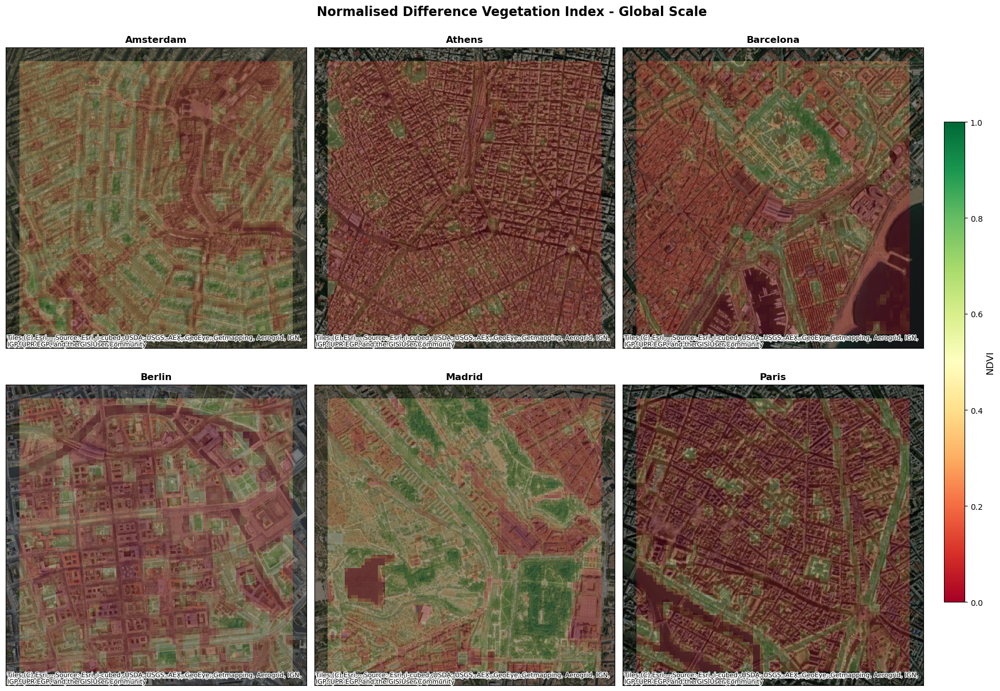

  Saved to /Users/gerardoezequiel/Developer/ShapingCoolCities/results/figures/gee_NDVI_global.png
Creating NDVI visualisation (intracity scale) with both basemaps (no attribution)...


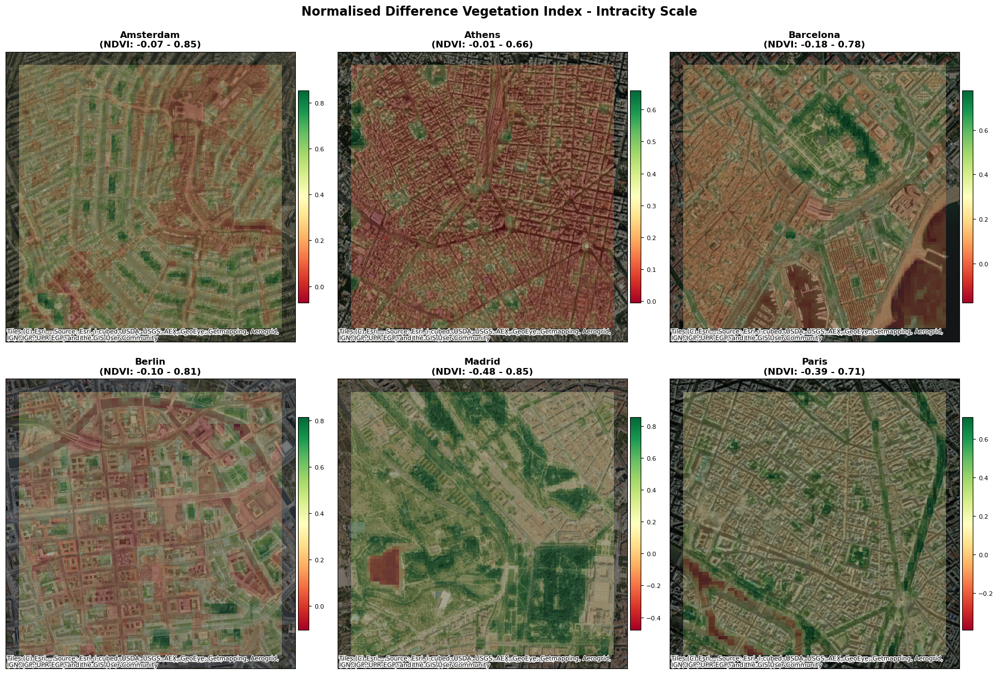

  Saved to /Users/gerardoezequiel/Developer/ShapingCoolCities/results/figures/gee_NDVI_intracity.png
Creating tree_canopy_cover visualisation (intracity scale) with both basemaps (no attribution)...


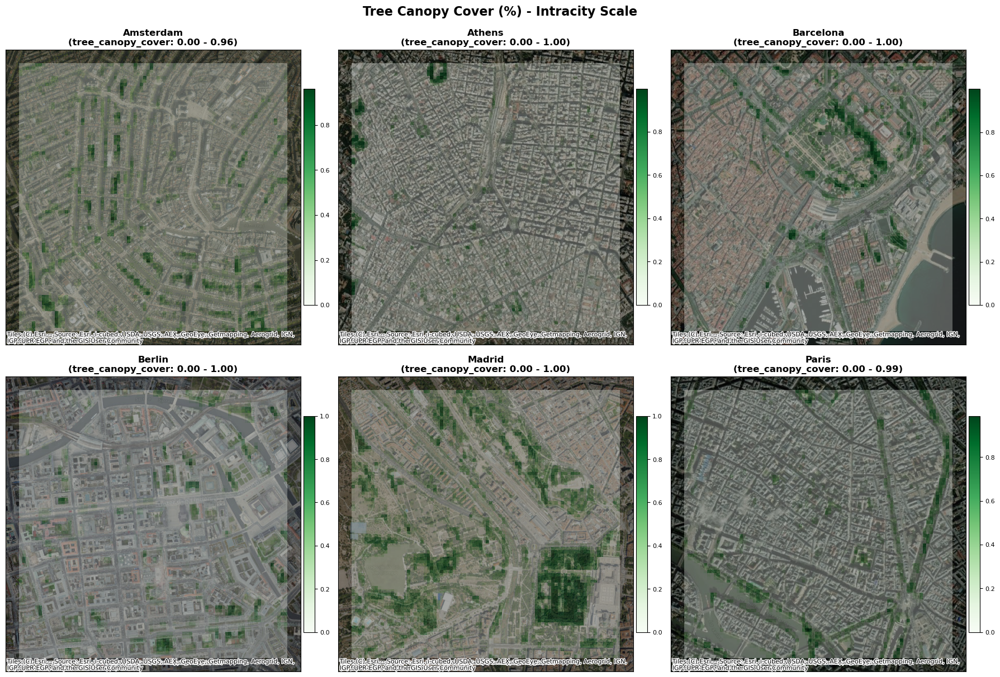

  Saved to /Users/gerardoezequiel/Developer/ShapingCoolCities/results/figures/gee_tree_canopy_cover_intracity.png
Visualisation creation complete!


In [56]:
def visualise_key_features(combined_dataset):
    """
    Visualise key GEE features using create_city_visualisation from gee_pipeline.
    """
    from IPython.display import display

    print("CREATING GEE FEATURE VISUALISATIONS")
    print("=" * 50)

    if combined_dataset is None:
        print("No combined dataset available for visualisation")
        return

    grid_path = GRID_PATHS[REFERENCE_RESOLUTION]
    if not grid_path or not grid_path.exists():
        print(f"30 m grid missing at {grid_path}; visualisations skipped")
        return

    vis_defs = [
        # (feature, title, cmap, vmin, vmax, basemap_source, use_global_scale, filename)
        ('LST_mean', 'Land Surface Temperature (°C) - Global Scale',   mpl.cm.RdYlBu_r, None, None, None, True,  'gee_LST_mean_global.png'),
        ('LST_mean', 'Land Surface Temperature (°C) - Intracity Scale',mpl.cm.RdYlBu_r, None, None, None, False, 'gee_LST_mean_intracity.png'),
        ('NDVI',     'Normalised Difference Vegetation Index - Global Scale', mpl.cm.RdYlGn, 0, 1, None, True, 'gee_NDVI_global.png'),
        ('NDVI',     'Normalised Difference Vegetation Index - Intracity Scale', mpl.cm.RdYlGn, None, None, None, False, 'gee_NDVI_intracity.png'),
        ('tree_canopy_cover', 'Tree Canopy Cover (%) - Intracity Scale', mpl.cm.Greens, None, None, None, False, 'gee_tree_canopy_cover_intracity.png'),
    ]

    for feature, title, cmap, vmin, vmax, basemap_source, use_global_scale, fname in vis_defs:
      def add_basemaps(ax):
        crs = getattr(ax, "projection", None)
        # Pass attribution=None to suppress basemap attribution render
        for source, alpha in [
            (ctx.providers.CartoDB.DarkMatter, 1),
            (ctx.providers.Esri.WorldImagery, 0.5)
        ]:
            try:
                ctx.add_basemap(ax, source=source, crs=crs, alpha=alpha, attribution=None)
            except Exception as e:
                print(f"Warning: Could not add basemap {source}: {e}")

    def plot_with_basemaps(*args, **kwargs):
        kwargs.pop('return_fig', None)
        fig = create_city_visualisation(*args, **kwargs)
        if fig is not None and hasattr(fig, "axes"):
            usable_axes = [
                ax for ax in fig.axes
                if ax.get_position().width > 0.08 and ax.get_position().height > 0.08
            ]
            for ax in usable_axes:
                add_basemaps(ax)
        return fig

    vis_defs = [
        # (feature, title, cmap, vmin, vmax, basemap_source, use_global_scale, filename)
        ('LST_mean', 'Land Surface Temperature (°C) - Global Scale',   mpl.cm.RdYlBu_r, None, None, ctx.providers.CartoDB.DarkMatter, True,  'gee_LST_mean_global.png'),
        ('LST_mean', 'Land Surface Temperature (°C) - Intracity Scale',mpl.cm.RdYlBu_r, None, None, ctx.providers.CartoDB.DarkMatter, False, 'gee_LST_mean_intracity.png'),
        ('NDVI',     'Normalised Difference Vegetation Index - Global Scale', mpl.cm.RdYlGn, 0, 1, ctx.providers.Esri.WorldImagery, True, 'gee_NDVI_global.png'),
        ('NDVI',     'Normalised Difference Vegetation Index - Intracity Scale', mpl.cm.RdYlGn, None, None, ctx.providers.Esri.WorldImagery, False, 'gee_NDVI_intracity.png'),
        ('tree_canopy_cover', 'Tree Canopy Cover (%) - Intracity Scale', mpl.cm.Greens, None, None, ctx.providers.Esri.WorldImagery, False, 'gee_tree_canopy_cover_intracity.png'),
    ]

    for feature, title, cmap, vmin, vmax, basemap_source, use_global_scale, fname in vis_defs:
        print(f"Creating {feature} visualisation ({'global' if use_global_scale else 'intracity'} scale) with both basemaps (no attribution)...")
        fig = plot_with_basemaps(
            combined_dataset,
            feature,
            title,
            cmap=cmap,
            vmin=vmin,
            vmax=vmax,
            basemap_source=basemap_source,
            use_global_scale=use_global_scale,
            grid_path=grid_path,
        )
        if fig is not None:
            display(fig)
            fig_path = FIG_DIR / fname
            fig.savefig(fig_path, dpi=300, bbox_inches='tight')
            plt.close(fig)
            print(f"  Saved to {fig_path}")

    print("Visualisation creation complete!")

combined_dataset_30m = combined_datasets_by_resolution.get(REFERENCE_RESOLUTION)
if combined_dataset_30m is None:
    try:
        combined_dataset_30m = pd.read_parquet(GEE_OUTPUT_FILES[REFERENCE_RESOLUTION])
    except FileNotFoundError:
        combined_dataset_30m = None

if combined_dataset_30m is not None:
    visualise_key_features(combined_dataset_30m)
else:
    print("30 m combined dataset unavailable. Run the 30 m export before visualising.")
